# Topic: Team detection based on image embeddings

In [2]:
import os
import warnings 
import plotly.express as px
import numpy as np
import pandas as pd

from ultralytics import YOLO
from PIL import Image


#### Step 1: load image data & trained model

In [3]:
#load images
frame_files = os.listdir('../data/processed/ultimate_detect/images/train/')
frames = [ Image.open('../data/processed/ultimate_detect/images/train/' + frame_file) 
        for frame_file in frame_files]

#load YOLOv8 model

model = YOLO('../model/best.pt')

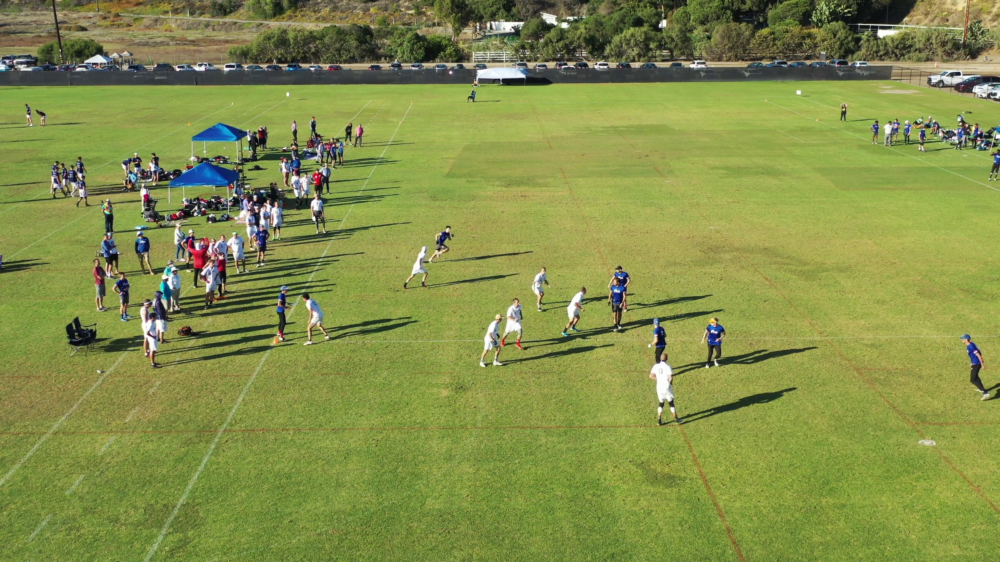

In [4]:
frame = frames[10]
frame

#### Step 2: Extract players using object detection model

In [5]:

#detect players and extract subimages
results = model.predict(frame, conf=0.2)

player_imgs = []
for result in results:
    for cls, box in zip(result.boxes.cls.tolist(), result.boxes.xyxy.tolist()):
        if cls == 0:
            #crop player boxes
            cropped_img = frame.crop(box).resize((128, 256))
            player_imgs.append(cropped_img)       


0: 2176x3840 23 Players, 1 Disc, 8475.7ms
Speed: 220.0ms preprocess, 8475.7ms inference, 20.1ms postprocess per image at shape (1, 3, 2176, 3840)


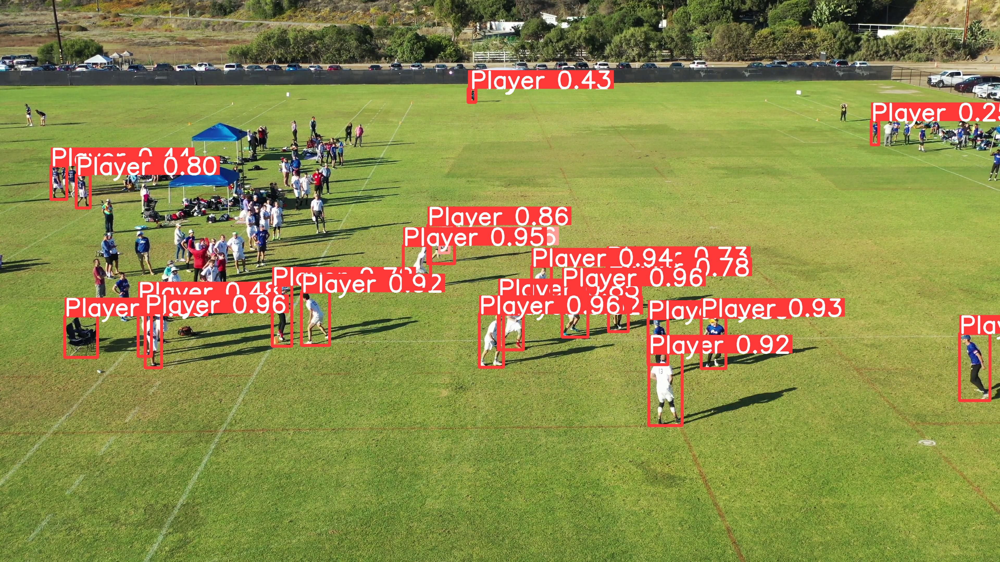

In [6]:
Image.fromarray(results[0].plot()[..., ::-1])

In [7]:
#show extracted players

import plotly.subplots as sp
import plotly.express as px

def plot_list_of_players(img_list:list[Image.Image],pred_labels:list[str] = None):
    fig = sp.make_subplots(rows=1, cols=len(img_list))

    for i, img in enumerate(img_list, start=1):
        fig.add_trace(
            px.imshow(img).data[0],
            row=1, col=i
        )
        
        if pred_labels is not None:
            fig.update_xaxes(title_text=str(pred_labels[i-1]), row=1, col=i)
    
    fig.show()

In [23]:
plot_list_of_players(player_imgs,None)

## Flatten image + Kmeans clustering

In [32]:
import typing as t
import numpy as np

from sklearn.cluster import KMeans
from PIL import Image


class TeamDetector():
    def __init__(self) -> None:
        pass

    def predict_teams(self, player_imgs: t.List[Image.Image]) -> t.List[int]:
        """
        Predicts the team labels for a list of player images.

        Args:
            player_imgs (List[Image.Image]): A list of player images.

        Returns:
            List[int]: A list of predicted team labels for each player image.
        """
         
        player_imgs_format = np.array([np.array(img).flatten() for img in player_imgs])

        kmeans = KMeans(n_clusters=2)
        pred_labels_kmeans = kmeans.fit_predict(player_imgs_format)
    
        if len(player_imgs_format) > 14:
            return pred_labels_kmeans
        
        #get distence for each sample to each cluster center
        cluster_distances = kmeans.transform(player_imgs_format)

        samples_class_1 = (pred_labels_kmeans == 1)
        samples_class_0 = (pred_labels_kmeans == 0)

        all_idxs = np.arange(len(player_imgs_format))

        # check if class 1 has more than 7 samples
        if np.sum(samples_class_1) > 7:
            class_1_kmeans_idxs = all_idxs[samples_class_1]
            class_1_selected_indices = self._select_n_closest_samples(1, class_1_kmeans_idxs, cluster_distances,7)
            class_0_selected_indices = np.setdiff1d(all_idxs, class_1_selected_indices)
        # check if class 0 has more than 7 samples
        elif np.sum(samples_class_0) > 7:
            class_0_kmeans_idxs = all_idxs[samples_class_0]
            class_0_selected_indices = self._select_n_closest_samples(0, class_0_kmeans_idxs, cluster_distances,7)
            class_1_selected_indices = np.setdiff1d(all_idxs, class_0_selected_indices)
        else:
            class_1_selected_indices = np.where(samples_class_1)[0]
            class_0_selected_indices = np.where(samples_class_0)[0]

        pred_labels = np.empty(len(self.player_imgs))
        pred_labels[class_1_selected_indices] = 1
        pred_labels[class_0_selected_indices] = 0

        return pred_labels.tolist()

    def _select_n_closest_samples(class_id, class_indices, cluster_distances, n=7):
        """
        Selects the n closest samples to the cluster center of the given class.

        Parameters:
        class_id (int): The ID of the class.
        class_indices (numpy.ndarray): An array of indices corresponding to the samples of the given class.
        cluster_distances (numpy.ndarray): A 2D array of distances between each sample and the cluster centers.
        n (int): The number of closest samples to select.

        Returns:
        numpy.ndarray: An array of indices corresponding to the selected closest samples.
        """
        class_indices_sorted_by_distance = class_indices[np.argsort(cluster_distances[:, class_id][class_indices])]
        selected_indices = class_indices_sorted_by_distance[:n]

        return selected_indices

In [33]:
test = TeamDetector()
pred_labels = test.predict_teams(player_imgs).tolist()

In [10]:
# Run PCA
#pca = PCA(n_components=3)
#data_pca = pca.fit_transform(data)

# Convert the PCA-reduced embeddings to a DataFrame
#df = pd.DataFrame(data_pca, columns=['Component 1', 'Component 2', 'Component 3'])

#cluster_centers = kmeans.cluster_centers_
#print(cluster_distances)
#center_images = cluster_centers.reshape(-1, *player_imgs[0].shape)
# Plot the PCA-reduced embeddings
#fig = px.scatter_3d(df, x='Component 1', y='Component 2', z='Component 3', color=pred_labels)
#fig.show()

## plot players and predicted labels

In [34]:
plot_list_of_players(player_imgs,pred_labels)